# Identically generated cohorts

Here I investigate the question: does CIBERSORTx infer differential expression when none truly exists?

CIBERSORTx infers:
1. Cell type-specific expression on average for an entire cohort
   - in other words, a "representative" cell type GEP for each cell type, given several bulk RNA-seq profiles
2. Cell type-specific expression for every sample in a cohort

Methods:
1. I create two cohorts of in silico-generated bulk RNA-seq
   - I generate these identically
     - same settings (e.g. # of single cells to sample per sample-specific cell type GEP)
     - same cell type fractions per sample (using estimated cell type fractions from TCGA SKCM mets)
   - The only difference is random sampling of single cell data
2. I compare the two cohorts
   - DEG analysis at a sample level
   - DEG analysis 

Questions I have...
- when false discovery occurs, why does it happen?
   - could it be a gene's sparsity in simulated bulk profiles?
   - could it be due to correlation with other genes?


## Imports and setup

In [1]:
import logging
import warnings

import cloudpathlib
import dask.dataframe as dd
import helpers
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly.io
import scipy.stats
from statsmodels.stats.multitest import multipletests

In [2]:
plotly.io.renderers.default

'plotly_mimetype+notebook'

In [3]:
warnings.filterwarnings("ignore", message="divide by zero")
warnings.filterwarnings("ignore", message="invalid value encountered in double_scalars")

In [4]:
from tqdm.autonotebook import tqdm

tqdm.pandas()

/tmp/ipykernel_11689/2614673571.py:1: TqdmExperimentalWarning:

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)



In [5]:
logger = logging.getLogger(__name__)
logger.setLevel("DEBUG")

# helpers.logging.configure_logging()
# udp_handler = logging.handlers.DatagramHandler("localhost", 12000)
# udp_handler.setLevel("DEBUG")
# logging.getLogger().addHandler(udp_handler)

stream_handler = logging.StreamHandler()
stream_handler.setFormatter(helpers.logging.formatter)
stream_handler.setLevel("INFO")
logging.getLogger().addHandler(stream_handler)

In [6]:
logger.debug("debug")
logger.info("info")
logger.warning("warn")

2022-09-06 01:19:28,319 11689/MainThread __main__ INFO
info
2022-09-06 01:19:28,320 11689/MainThread __main__ WARNING
warn


In [7]:
path_root = cloudpathlib.CloudPath(
    "gs://liulab/evaluating_cibersortx/identical_cohorts/2022-08-25_05:53:48/"
)

In [8]:
!gsutil ls -hlR {path_root} | grep pseudo

180.83 MiB  2022-08-25T08:52:06Z  gs://liulab/evaluating_cibersortx/identical_cohorts/2022-08-25_05:53:48/running_both_jointly/pseudobulk_rnaseq.tsv
 90.45 MiB  2022-08-25T13:42:49Z  gs://liulab/evaluating_cibersortx/identical_cohorts/2022-08-25_05:53:48/running_individually/0/pseudobulk_rnaseq.tsv
 90.48 MiB  2022-08-25T13:42:03Z  gs://liulab/evaluating_cibersortx/identical_cohorts/2022-08-25_05:53:48/running_individually/1/pseudobulk_rnaseq.tsv


## Analysis of known bulk RNA-seq and cell type GEPs (generated in silico)

What does DEG analysis look like for the in silico generated cohorts?

A priori, no genes are differentially expressed... But checking differential expression gives us a baseline of what to expect in terms of false discovery of DEGs.

### Sample-level DEG analysis

#### load data

In [9]:
def load_simulated_bulkrnaseq():
    # uri = "gs://liulab/evaluating_cibersortx/identical_cohorts/2022-08-11_03:41:30/*/data/bulkrnaseq.txt"
    uri = str(path_root / "running_individually" / "*" / "pseudobulk_rnaseq.tsv")
    df = dd.read_csv(uri, sep="\t", include_path_column=True).compute()
    df[["cohort_id"]] = df["path"].str.extract(".*/(.*)/pseudobulk_rnaseq.tsv")
    df = df.drop(columns="path")
    df = df.pivot(index=["cohort_id", "GeneSymbol"], columns=[])
    df = df.rename_axis(columns="sample_id")
    df = df.stack()
    # df = df.set_index(["cohort_id", "GeneSymbol"])
    return df

In [10]:
%%time
df_bulkrnaseq = load_simulated_bulkrnaseq()

CPU times: user 4.11 s, sys: 350 ms, total: 4.46 s
Wall time: 3.71 s


In [11]:
df_bulkrnaseq

cohort_id  GeneSymbol  sample_id                   
0          A1BG        TCGA-3N-A9WB-06A-11R-A38C-07     44.044627
                       TCGA-3N-A9WC-06A-11R-A38C-07     89.240604
                       TCGA-3N-A9WD-06A-11R-A38C-07     60.240547
                       TCGA-BF-AAP0-06A-11R-A39D-07     53.463504
                       TCGA-D3-A1Q1-06A-21R-A18T-07    131.733534
                                                          ...    
1          ZZZ3        TCGA-YG-AA3O-06A-11R-A38C-07     60.696120
                       TCGA-YG-AA3P-06A-11R-A38C-07    104.668394
                       TCGA-Z2-A8RT-06A-11R-A37K-07     12.266973
                       TCGA-Z2-AA3S-06A-11R-A39D-07     36.512972
                       TCGA-Z2-AA3V-06A-11R-A39D-07    126.039951
Length: 11822368, dtype: float64

In [12]:
df_bulkrnaseq.loc["0", :, "TCGA-3N-A9WB-06A-11R-A38C-07"]

GeneSymbol
A1BG       44.044627
A2M       309.115414
A2ML1      11.181503
A4GALT      2.048772
A4GNT       0.000000
             ...    
ZYG11A     96.556796
ZYG11B    115.817748
ZYX        16.040418
ZZEF1      83.220785
ZZZ3        8.914606
Length: 16063, dtype: float64

In [13]:
(df_bulkrnaseq == 0).mean()

0.17048834886547265

#### compute stats

In [14]:
def compute_stats_for_group(df: pd.DataFrame) -> pd.Series:
    logger.debug("computing stats for group %s", df.name)
    data_0, data_1 = df.loc["0"], df.loc["1"]
    # logger.debug((data_0.shape, data_1.shape))
    results = pd.Series(
        {
            "pval": scipy.stats.mannwhitneyu(data_0, data_1)[1],
            # "pval_ttest": scipy.stats.ttest_ind(data_0, data_1).pvalue,
            "fold_change": data_0.mean() / data_1.mean(),
            "sparsity_overall": (df == 0).mean(),
        }
    )
    logging.debug(results)
    return results


def add_multipletests_stats(df):
    df["-log10_pval"] = -np.log10(df["pval"])
    df["log2_fold_change"] = np.log2(df["fold_change"])
    sign = np.sign(df["log2_fold_change"])
    df["-log10_pval_signed"] = df["-log10_pval"] * sign
    # multiple hypothesis testing with benjamini-hochberg
    df["significant_bh_fdr=0.5"], df["pval_adj_bh"] = multipletests(
        df["pval"], alpha=0.5, method="fdr_bh"
    )[0:2]
    df["-log10_pval_adj_bh"] = -np.log10(df["pval_adj_bh"])
    df["-log10_pval_adj_bh_signed"] = df["-log10_pval_adj_bh"] * sign
    return df


def compute_stats(groups):
    df_stats_by_group = groups.progress_apply(compute_stats_for_group)
    df_stats_by_group = df_stats_by_group.unstack(level=-1)
    df_stats_by_group = df_stats_by_group.reset_index()
    df_stats_by_group = add_multipletests_stats(df_stats_by_group)
    return df_stats_by_group

In [15]:
%%time

groups = df_bulkrnaseq.groupby("GeneSymbol")
df_bulkrnaseq_stats = compute_stats(groups)
df_bulkrnaseq_stats

  0%|          | 0/16063 [00:00<?, ?it/s]

CPU times: user 41.1 s, sys: 305 ms, total: 41.4 s
Wall time: 41.1 s


,GeneSymbol,pval,fold_change,sparsity_overall,-log10_pval,log2_fold_change,-log10_pval_signed,significant_bh_fdr=0.5,pval_adj_bh,-log10_pval_adj_bh,-log10_pval_adj_bh_signed
0,A1BG,0.907251,1.049181,0.019022,0.042272,0.069264,0.042272,False,0.987473,0.005475,0.005475
1,A2M,0.077256,0.910396,0.000000,1.112068,-0.135434,-1.112068,False,0.744462,0.128158,-0.128158
2,A2ML1,0.429900,0.907533,0.000000,0.366633,-0.139978,-0.366633,False,0.888852,0.051171,-0.051171
3,A4GALT,0.536062,0.908466,0.035326,0.270785,-0.138496,-0.270785,False,0.917021,0.037621,-0.037621
4,A4GNT,0.545706,1.130752,0.908967,0.263042,0.177282,0.263042,False,0.917021,0.037621,0.037621
...,...,...,...,...,...,...,...,...,...,...,...
16058,ZYG11A,0.022443,0.923102,0.000000,1.648924,-0.115438,-1.648924,False,0.713991,0.146307,-0.146307
16059,ZYG11B,0.896955,0.982498,0.000000,0.047229,-0.025473,-0.047229,False,0.986727,0.005803,-0.005803
16060,ZYX,0.362258,0.970343,0.000000,0.440981,-0.043433,-0.440981,False,0.873455,0.058759,-0.058759
16061,ZZEF1,0.796290,1.024500,0.000000,0.098929,0.034920,0.098929,False,0.968886,0.013727,0.013727


In [16]:
df_bulkrnaseq_stats["significant_bh_fdr=0.5"].value_counts()

False    16063
Name: significant_bh_fdr=0.5, dtype: int64

#### results

#### plot

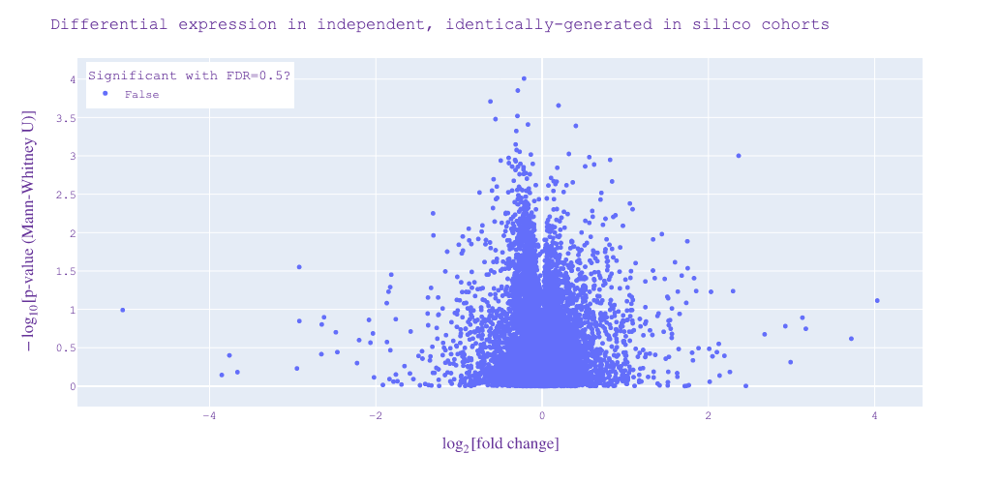

In [47]:
fig = px.scatter(
    df_bulkrnaseq_stats,
    x="log2_fold_change",
    y="-log10_pval",
    color="significant_bh_fdr=0.5",
    hover_name="GeneSymbol",
    hover_data=["pval", "pval_adj_bh", "sparsity_overall"],
)
fig.update_layout(
    title="Differential expression in independent, identically-generated in silico cohorts",
    xaxis_title=r"$\log_{2} [\text{fold change}]$",
    yaxis_title=r"$-\log_{10} [\text{p-value (Mann-Whitney U)}]$",
    legend_title="Significant with FDR=0.5?",
    font=dict(family="Courier New, monospace", color="RebeccaPurple"),
    height=500,
)
fig.update_traces(marker=dict(size=5))
# fig.show(renderer="png", width=1000, height=800, scale=2)
fig.update_layout(legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))
fig

### Sample, cell type-level DEG analysis

#### load data

In [18]:
def load_simulated_cell_type_geps():
    def read_stuff(i):
        return pd.read_parquet(
            path_root
            / "running_individually"
            / str(i)
            / "all_simulated_data"
            / "simulated_cell_type_geps.parquet",
        )

    df = pd.concat({str(i): read_stuff(i) for i in [0, 1]}, names=["cohort_id"])
    df = df.rename_axis(columns="cell_type")
    df = df.stack().unstack("sample_id")
    return df

In [19]:
df_simulated_cell_type_geps = load_simulated_cell_type_geps()

#### compute stats

#### plots

### Only malignant GEPs (todo)

## DEG analysis of CIBERSORTx-inferred cell type GEPs (deconvolved jointly)

### load data

In [27]:
def load_df_inferred_cell_type_geps_from_jointly():
    uri = str(
        path_root
        / "running_both_jointly"
        / "outdir"
        / "CIBERSORTxHiRes_NA_*_Window36.txt"
    )
    logger.debug("reading")
    df = (
        dd.read_csv(uri, sep="\t", include_path_column=True)
        # .sample(frac=1e-2, random_state=np.random.default_rng(seed=0))
        .compute()
    )
    logger.debug("extracting cell_type from path")
    df["cell_type"] = df["path"].str.extract(".*/CIBERSORTxHiRes_NA_(.*)_Window36.txt")
    df = df.drop(columns="path")
    logger.debug("pivoting")
    df = df.pivot(index=["GeneSymbol", "cell_type"], columns=[])
    logger.debug("changing column hierarchy")
    df.columns = pd.MultiIndex.from_tuples(
        [(sample_id[6], sample_id[8:]) for sample_id in df.columns],
        names=["cohort_id", "sample_id"],
    )
    logger.debug("stacking")
    df = df.stack(level=["cohort_id", "sample_id"])
    logger.debug("reordering index levels")
    df.index = df.index.reorder_levels(
        ["cohort_id", "GeneSymbol", "cell_type", "sample_id"]
    )
    logger.debug("done")
    return df

In [28]:
%%time
df_inferred_cell_type_geps_from_jointly = load_df_inferred_cell_type_geps_from_jointly()

CPU times: user 27.7 s, sys: 5.5 s, total: 33.2 s
Wall time: 15.7 s


In [29]:
df_inferred_cell_type_geps_from_jointly.tail()

cohort_id  GeneSymbol  cell_type  sample_id                   
1          ZZEF1       T          TCGA-YG-AA3O-06A-11R-A38C-07    79.512054
                                  TCGA-YG-AA3P-06A-11R-A38C-07    79.512054
                                  TCGA-Z2-A8RT-06A-11R-A37K-07    79.512054
                                  TCGA-Z2-AA3S-06A-11R-A39D-07    79.512054
                                  TCGA-Z2-AA3V-06A-11R-A39D-07    79.512054
dtype: float64

In [30]:
df_inferred_cell_type_geps_from_jointly.sample(20)

cohort_id  GeneSymbol  cell_type    sample_id                   
1          ADIPOR1     Macrophage   TCGA-EE-A29H-06A-12R-A18S-07    648.738545
0          LRRIQ1      NK           TCGA-EE-A29M-06A-11R-A18T-07      1.000000
           HCG18       B            TCGA-EE-A17Z-06A-11R-A18S-07    111.643253
1          LCE2A       T            TCGA-D3-A51J-06A-11R-A266-07      1.000000
           NACA        Endothelial  TCGA-FS-A1ZT-06A-11R-A18U-07    938.732108
           PCDHGC5     T            TCGA-GN-A265-06A-21R-A18T-07      1.000000
0          PSME1       Endothelial  TCGA-D3-A3CC-06A-11R-A18S-07    757.954008
1          RBMS1       T            TCGA-EB-A44Q-06A-11R-A266-07    194.218432
           AVEN        CAF          TCGA-GN-A262-06A-11R-A18T-07     10.056308
           C5orf42     TCD8         TCGA-D3-A1QB-06A-11R-A18T-07      1.000000
0          CAT         TCD4         TCGA-EE-A3J3-06A-11R-A20F-07    287.668120
1          PRDM1       TCD8         TCGA-D3-A3CF-06A-11R-A18T-07  

In [31]:
df_inferred_cell_type_geps_from_jointly.loc[:, "PDE6A", "Malignant", :]

cohort_id  sample_id                   
0          TCGA-3N-A9WB-06A-11R-A38C-07    104.633930
           TCGA-3N-A9WC-06A-11R-A38C-07     56.390120
           TCGA-3N-A9WD-06A-11R-A38C-07     77.868167
           TCGA-BF-AAP0-06A-11R-A39D-07     66.629835
           TCGA-D3-A1Q1-06A-21R-A18T-07     39.910429
                                              ...    
1          TCGA-YG-AA3O-06A-11R-A38C-07     64.578705
           TCGA-YG-AA3P-06A-11R-A38C-07     53.499051
           TCGA-Z2-A8RT-06A-11R-A37K-07     33.617860
           TCGA-Z2-AA3S-06A-11R-A39D-07     42.692135
           TCGA-Z2-AA3V-06A-11R-A39D-07     58.157231
Length: 736, dtype: float64

In [32]:
df_inferred_cell_type_geps_from_jointly.loc[:, "PDE6A", :, :].groupby(
    ["cell_type"]
).apply(lambda data: scipy.stats.mannwhitneyu(data.loc["0"], data.loc["1"]).pvalue)

cell_type
B             1.000000
CAF           1.000000
Macrophage    1.000000
Malignant     0.509904
NK            1.000000
T             1.000000
TCD4          1.000000
TCD8          1.000000
dtype: float64

In [33]:
df_inferred_cell_type_geps_from_jointly.groupby(
    ["cell_type", "cohort_id"]
).count().unstack(level=1) / 368

cohort_id,0,1
cell_type,,
B,8353.0,8353.0
CAF,12280.0,12280.0
Endothelial,8272.0,8272.0
Macrophage,8574.0,8574.0
Malignant,15369.0,15369.0
NK,8340.0,8340.0
T,8722.0,8722.0
TCD4,8316.0,8316.0
TCD8,8136.0,8136.0


### compute stats

In [34]:
%%time

groups = df_inferred_cell_type_geps_from_jointly.groupby(["cell_type", "GeneSymbol"])
df_inferred_cell_type_geps_from_jointly_stats = compute_stats(groups)
df_inferred_cell_type_geps_from_jointly_stats

  0%|          | 0/86362 [00:00<?, ?it/s]

CPU times: user 3min 24s, sys: 1.27 s, total: 3min 25s
Wall time: 3min 24s


,cell_type,GeneSymbol,pval,fold_change,sparsity_overall,-log10_pval,log2_fold_change,-log10_pval_signed,significant_bh_fdr=0.5,pval_adj_bh,-log10_pval_adj_bh,-log10_pval_adj_bh_signed
0,B,A1BG,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
1,B,A2M,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
2,B,A2ML1,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
3,B,A4GALT,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
4,B,A4GNT,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
86357,TCD8,ZXDB,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
86358,TCD8,ZXDC,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
86359,TCD8,ZYG11A,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0
86360,TCD8,ZYG11B,1.0,1.0,0.0,-0.0,0.0,-0.0,False,1.0,-0.0,-0.0


### plots

In [35]:
df_inferred_cell_type_geps_from_jointly_stats.shape

(86362, 12)

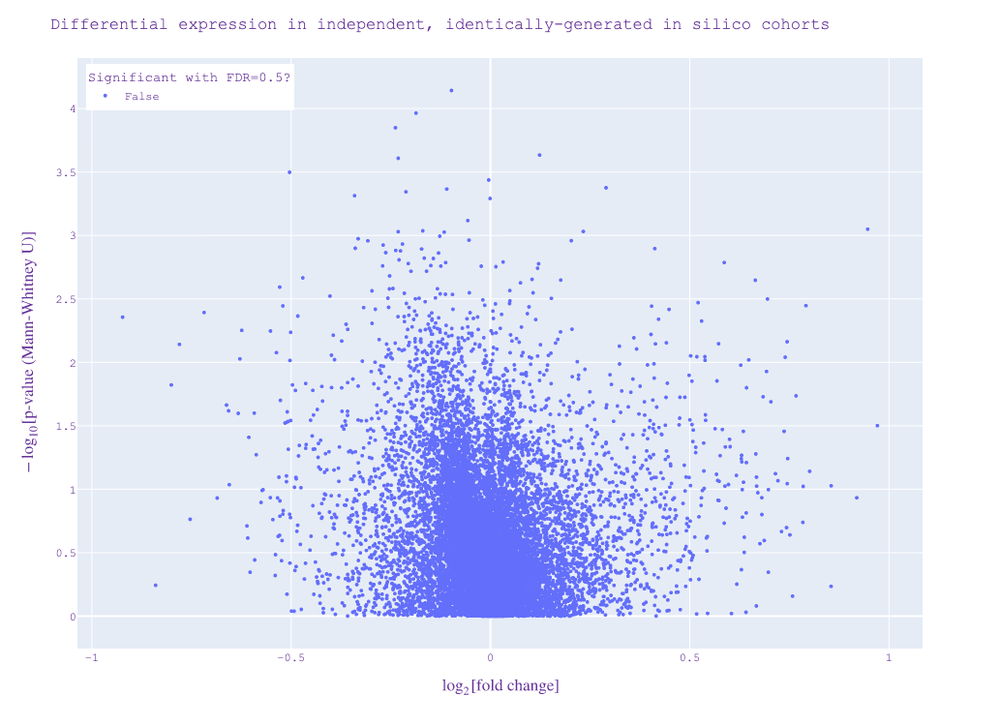

In [72]:
# df_stats_groundtruth_bulks = pd.

fig = px.scatter(
    df_inferred_cell_type_geps_from_jointly_stats,
    x="log2_fold_change",
    y="-log10_pval",
    color="significant_bh_fdr=0.5",
    hover_name="GeneSymbol",
    hover_data=["pval", "pval_adj_bh", "sparsity_overall"],
)
fig.update_layout(
    title="Differential expression in independent, identically-generated in silico cohorts",
    xaxis_title=r"$\log_{2} [\text{fold change}]$",
    yaxis_title=r"$-\log_{10} [\text{p-value (Mann-Whitney U)}]$",
    font=dict(family="Courier New, monospace", color="RebeccaPurple"),
    legend=dict(
        title="Significant with FDR=0.5?", yanchor="top", y=0.99, xanchor="left", x=0.01
    ),
    height=750,
)
fig.update_traces(marker=dict(size=4))
fig

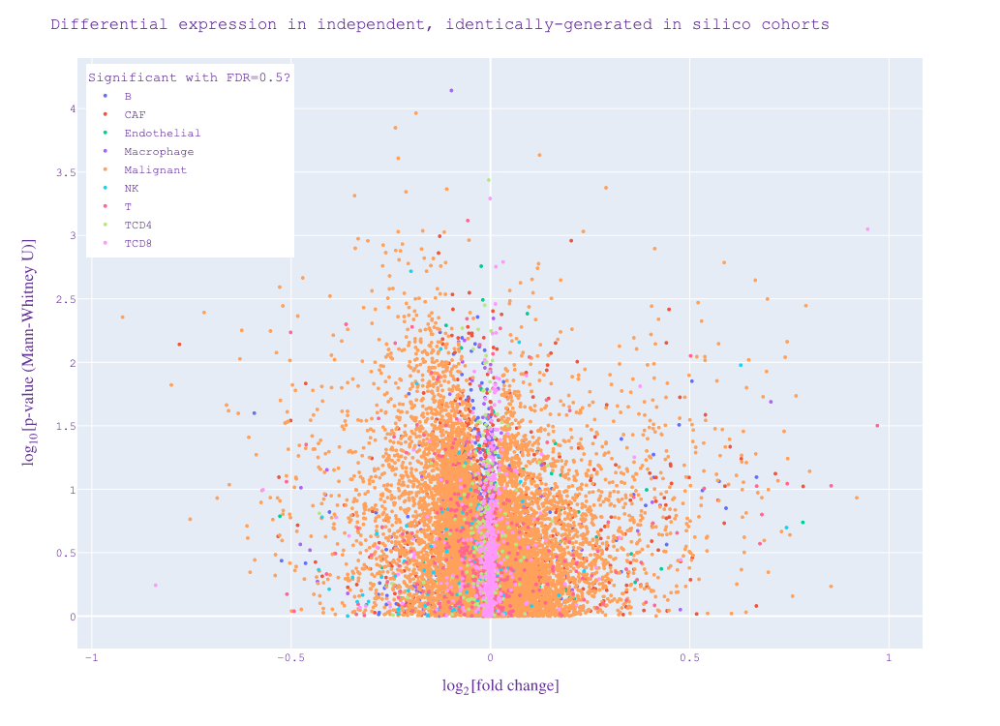

In [73]:
# df_stats_groundtruth_bulks = pd.

fig = px.scatter(
    df_inferred_cell_type_geps_from_jointly_stats,
    x="log2_fold_change",
    y="-log10_pval",
    color="cell_type",
    hover_name="GeneSymbol",
    hover_data=["cell_type", "pval", "pval_adj_bh", "sparsity_overall"],
)
fig.update_layout(
    title="Differential expression in independent, identically-generated in silico cohorts",
    xaxis_title=r"$\log_{2} [\text{fold change}]$",
    yaxis_title=r"$\log_{10} [\text{p-value (Mann-Whitney U)}]$",
    font=dict(family="Courier New, monospace", color="RebeccaPurple"),
    legend=dict(
        title="Significant with FDR=0.5?", yanchor="top", y=0.99, xanchor="left", x=0.01
    ),
    height=750,
)
fig.update_traces(marker=dict(size=4))
fig

todo:
- modify volcano plot:
  - plot original p-values
  - add a horizontal lines corresponding to FDR = 0.1, 0.5

## DEG analysis of CIBERSORTx-inferred cell type GEPs (deconvolved separately)

Does CIBERSORTx infer more DEG than what actually exists in the data?

### load data

In [20]:
def load_df_inferred_cell_type_geps():
    # uri = "gs://liulab/evaluating_cibersortx/identical_cohorts/2022-08-11_03:41:30/*/outdir/CIBERSORTxHiRes_NA_*_Window36.txt"
    uri = str(
        path_root
        / "running_individually"
        / "*"
        / "outdir"
        / "CIBERSORTxHiRes_NA_*_Window36.txt"
    )
    df = dd.read_csv(uri, sep="\t", include_path_column=True).compute()
    df[["cohort_id", "cell_type"]] = df["path"].str.extract(
        ".*/(.*)/outdir/CIBERSORTxHiRes_NA_(.*)_Window36.txt"
    )
    df = df.drop(columns="path")
    df = df.pivot(index=["cohort_id", "GeneSymbol", "cell_type"], columns=[])
    df = df.rename_axis(columns="sample_id")
    df = df.stack()
    return df

In [21]:
%%time
df_inferred_cell_type_geps = load_df_inferred_cell_type_geps()

CPU times: user 23.5 s, sys: 3.44 s, total: 26.9 s
Wall time: 12.6 s


In [22]:
df_inferred_cell_type_geps

cohort_id  GeneSymbol  cell_type  sample_id                   
0          A1BG        B          TCGA-3N-A9WB-06A-11R-A38C-07    1.0
                                  TCGA-3N-A9WC-06A-11R-A38C-07    1.0
                                  TCGA-3N-A9WD-06A-11R-A38C-07    1.0
                                  TCGA-BF-AAP0-06A-11R-A39D-07    1.0
                                  TCGA-D3-A1Q1-06A-21R-A18T-07    1.0
                                                                 ... 
1          ZZEF1       T          TCGA-YG-AA3O-06A-11R-A38C-07    1.0
                                  TCGA-YG-AA3P-06A-11R-A38C-07    1.0
                                  TCGA-Z2-A8RT-06A-11R-A37K-07    1.0
                                  TCGA-Z2-AA3S-06A-11R-A39D-07    1.0
                                  TCGA-Z2-AA3V-06A-11R-A39D-07    1.0
Length: 60125680, dtype: float64

In [26]:
df_inferred_cell_type_geps.loc[:, "PDE6A", :, :].groupby(["cell_type"]).apply(
    lambda data: print(data.groupby("cohort_id").size())
)

cohort_id
0    368
1    368
Name: B, dtype: int64
cohort_id
0    368
1    368
Name: CAF, dtype: int64
cohort_id
1    368
Name: Macrophage, dtype: int64
cohort_id
0    368
1    368
Name: Malignant, dtype: int64
cohort_id
1    368
Name: NK, dtype: int64
cohort_id
0    368
1    368
Name: T, dtype: int64
cohort_id
0    368
1    368
Name: TCD4, dtype: int64
cohort_id
0    368
1    368
Name: TCD8, dtype: int64


cell_type
B             None
CAF           None
Macrophage    None
Malignant     None
NK            None
T             None
TCD4          None
TCD8          None
dtype: object

In [23]:
df_inferred_cell_type_geps.loc[:, "PDE6A", :, :].groupby(["cell_type"]).apply(
    lambda data: scipy.stats.mannwhitneyu(data.loc["0"], data.loc["1"]).pvalue
)

KeyError: '0'

In [ ]:
df_inferred_cell_type_geps.loc[:, "PDE6A", :, :].to_frame("expression").reset_index()

In [ ]:
df_inferred_cell_type_geps.loc[:, :, :, "TCGA-3N-A9WB-06A-11R-A38C-07"].groupby(
    ["cell_type", "cohort_id"]
).count().unstack(level=1)

In [ ]:
df_inferred_cell_type_geps = df_inferred_cell_type_geps.groupby(
    ["cell_type", "GeneSymbol"]
).filter(
    lambda group: len(group) == 736  # has both cohorts
)

In [ ]:
df_inferred_cell_type_geps.loc[:, :, :, "TCGA-3N-A9WB-06A-11R-A38C-07"].groupby(
    ["cell_type", "cohort_id"]
).count().unstack(level=1)

### compute stats

In [ ]:
%%time

groups = df_inferred_cell_type_geps.groupby(["cell_type", "GeneSymbol"])
df_inferred_cell_type_geps_stats = compute_stats(groups)
df_inferred_cell_type_geps_stats

### plots

In [ ]:
fig = px.scatter(
    df_inferred_cell_type_geps_stats,
    x="log2_fold_change",
    y="-log10_pval_adj_bh",
    color="significant_bh_fdr=0.5",
    hover_name="GeneSymbol",
    hover_data=["cell_type", "pval", "pval_adj_bh", "sparsity_overall"],
)
fig.update_layout(
    title="Differential expression in independent, identically-generated in silico cohorts",
    xaxis_title=r"$\log_{2} [\text{fold change}]$",
    yaxis_title=r"$\log_{10} [\text{p-value, B-H adjusted (Mann-Whitney U)}]$",
    # yaxis_title=r"$\text{p-value, B-H adjusted (Mann-Whitney U)}$",
    legend_title="Significant with FDR=0.5?",
    font=dict(family="Courier New, monospace", color="RebeccaPurple"),
)
fig.update_traces(marker=dict(size=5))
# fig.show(renderer="png", width=1000, height=800, scale=2)
fig

In [ ]:
fig = px.scatter(
    df_inferred_cell_type_geps_stats,
    x="log2_fold_change",
    y="-log10_pval_adj_bh",
    color="cell_type",
    hover_name="GeneSymbol",
    hover_data=["cell_type", "pval", "pval_adj_bh", "sparsity_overall"],
)
fig.update_layout(
    title="Differential expression in independent, identically-generated in silico cohorts",
    xaxis_title=r"$\log_{2} [\text{fold change}]$",
    yaxis_title=r"$\log_{10} [\text{p-value, B-H adjusted (Mann-Whitney U)}]$",
    # yaxis_title=r"$\text{p-value, B-H adjusted (Mann-Whitney U)}$",
    legend_title="Significant with FDR=0.5?",
    font=dict(family="Courier New, monospace", color="RebeccaPurple"),
)
fig.update_traces(marker=dict(size=5))
# fig.show(renderer="png", width=1000, height=800, scale=2)
fig

## Appendix

From CIBERSORTx Supplementary Figures:
- 9\. Analysis of primary tumor specimens with  high-resolution CIBERSORTx.
  - 9.2. NSCLC.
    > Following high-resolution purification, cell type-specific DEGs were identified between LUAD and LUSC tumor samples by a two-sided unequal variance t test applied to log2 adjusted expression data.
    
    > To filter DEGs for significance, we used an empirically derived threshold (log2 fold change >0.1) that maximized the sensitivity and specificity of DEG recovery in simulated melanoma tumors (see ‘Simulated melanoma tumors with eight cell types’ and Supplementary Fig. 10) coupled with a Q value threshold (Benjamini-Hochberg) of <0.5 for additional stringency.
